## Objective 

This project provides a comprehensive analysis of job market data. The dataset includes various attributes related to job postings, such as experience required, salary details, job locations, and ratings. The analysis covers multiple aspects to gain insights into job trends, salary distributions, and job ratings across different titles and locations.

## Import Libraries

In [3]:
import pandas as pd 
import numpy as np 

In [5]:
# Data Visualization 
import matplotlib.pyplot as plt 
import seaborn as sns 

In [7]:
# warning remove alerts
import warnings
warnings.filterwarnings('ignore')

## Load the dataset

In [10]:
data = pd.read_csv('dataAnalystJobsIndia.csv')

### Starting 5 rows 

In [13]:
# Display the first few rows of each dataset
data.head()

,Sr_no,job_title,company,experience,min_exp,max_exp,base_salary,max_salary,location,jobListed(days_ago),postedIn,rating,reviews_count,details,salary_data_provide_by
0,0,JP Morgan Chase - Client Data Analyst (4-8 yrs),JP Morgan Chase,4-8 Yrs,4.0,8.0,NaN,NaN,Hyderabad / Secunderabad,3,iimjobs,4.1,5300.0,"Banking, KYC, Banking Operations",NaN
1,1,Data Analyst - Bangalore,Schneider Electric,5-10 Yrs,5.0,10.0,800000.0,1600000.0,"Bangalore / Bengaluru, Bangalore Rural",4,Naukri,4.2,3500.0,"ERP, SAP, Data Analysis",Salary Listed by Company
2,2,Senior IT ATLAS Data Analyst and Integration S...,SAP Labs India Pvt. Ltd.,7-11 Yrs,7.0,11.0,NaN,NaN,Bangalore / Bengaluru,7,Naukri,4.3,1500.0,"data quality, Data analysis, quality management",NaN
3,3,Consultant Data Analyst,Pfizer,2-6 Yrs,2.0,6.0,NaN,NaN,Mumbai,3,Naukri,4.1,1700.0,"Power Bi, Commercial Operations, Data Management",NaN
4,4,Senior Data Analyst - Retail Liabilities,IDFC FIRST Bank,5-10 Yrs,5.0,10.0,NaN,NaN,Mumbai,5,Naukri,4.5,2300.0,"Test strategy, Analytical, Manager Technology",NaN


### End 5 rows 

In [16]:
data.tail()

,Sr_no,job_title,company,experience,min_exp,max_exp,base_salary,max_salary,location,jobListed(days_ago),postedIn,rating,reviews_count,details,salary_data_provide_by
1556,1556,Data Analyst / Sr. Data Analyst,CoreInsightsAI,0-8 Yrs,0.0,8.0,NaN,NaN,Remote,150,Naukri,NaN,NaN,"Data analysis, Analytical, Consulting",NaN
1557,1557,Artificial intelligence Architect,Cotocus.com,4-9 Yrs,4.0,9.0,NaN,NaN,Bangalore / Bengaluru,365,Naukri,NaN,NaN,"Cloud computing, Machine learning, Analytical",NaN
1558,1558,Data Analysts,Cotocus.com,1-4 Yrs,1.0,4.0,NaN,NaN,Bangalore / Bengaluru,365,Naukri,NaN,NaN,"Analytical, Continuous improvement, Data Analyst",NaN
1559,1559,Data Architect,Cotocus.com,6-10 Yrs,6.0,10.0,NaN,NaN,Bangalore / Bengaluru,365,Naukri,NaN,NaN,"Scrum, Data analysis, Data management",NaN
1560,1560,Data analyst,Zecotok,1-3 Yrs,1.0,3.0,NaN,NaN,Panchkula,180,Naukri,NaN,NaN,"Data analysis, Programming, Data Analyst",NaN


## Information about data

### Shape 

In [20]:
data.shape

(1561, 15)

### Size 

In [23]:
data.size 

23415

### Columns 

In [26]:
data.columns

Index(['Sr_no', 'job_title', 'company', 'experience', 'min_exp', 'max_exp',
       'base_salary', 'max_salary', 'location', 'jobListed(days_ago)',
       'postedIn', 'rating', 'reviews_count', 'details',
       'salary_data_provide_by'],
      dtype='object')

### Info 

In [29]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1561 entries, 0 to 1560
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Sr_no                   1561 non-null   int64  
 1   job_title               1561 non-null   object 
 2   company                 1561 non-null   object 
 3   experience              1527 non-null   object 
 4   min_exp                 1527 non-null   float64
 5   max_exp                 1527 non-null   float64
 6   base_salary             343 non-null    float64
 7   max_salary              343 non-null    float64
 8   location                1528 non-null   object 
 9   jobListed(days_ago)     1561 non-null   int64  
 10  postedIn                1561 non-null   object 
 11  rating                  1124 non-null   float64
 12  reviews_count           1124 non-null   float64
 13  details                 1528 non-null   object 
 14  salary_data_provide_by  343 non-null    

### Dtypes 

In [32]:
data.dtypes

Sr_no                       int64
job_title                  object
company                    object
experience                 object
min_exp                   float64
max_exp                   float64
base_salary               float64
max_salary                float64
location                   object
jobListed(days_ago)         int64
postedIn                   object
rating                    float64
reviews_count             float64
details                    object
salary_data_provide_by     object
dtype: object

### Check Duplicates 

In [35]:
data.duplicated() 

0       False
1       False
2       False
3       False
4       False
        ...  
1556    False
1557    False
1558    False
1559    False
1560    False
Length: 1561, dtype: bool

In [37]:
data[data.duplicated()]     # To check row wise and detect the Duplicate rows

,Sr_no,job_title,company,experience,min_exp,max_exp,base_salary,max_salary,location,jobListed(days_ago),postedIn,rating,reviews_count,details,salary_data_provide_by


### Check Null Values

In [40]:
data.isnull().sum()

Sr_no                        0
job_title                    0
company                      0
experience                  34
min_exp                     34
max_exp                     34
base_salary               1218
max_salary                1218
location                    33
jobListed(days_ago)          0
postedIn                     0
rating                     437
reviews_count              437
details                     33
salary_data_provide_by    1218
dtype: int64

### Handle missing values  

In [43]:
from sklearn.impute import SimpleImputer

In [45]:
# Impute numeric columns
salary_imputer = SimpleImputer(strategy='median')
data[['base_salary', 'max_salary']] = salary_imputer.fit_transform(data[['base_salary', 'max_salary']])

rating_reviews_imputer = SimpleImputer(strategy='median')
data[['rating', 'reviews_count']] = rating_reviews_imputer.fit_transform(data[['rating', 'reviews_count']])

In [47]:
# Impute categorical columns
data['location'].fillna(data['location'].mode()[0], inplace=True)
data['details'].fillna('Not Provided', inplace=True)

In [49]:
# Drop column 'salary_data_provide_by' as it is entirely missing
data.drop(columns=['salary_data_provide_by'], inplace=True)

In [51]:
# Verify the final state of missing values
print(data.isnull().sum())

Sr_no                   0
job_title               0
company                 0
experience             34
min_exp                34
max_exp                34
base_salary             0
max_salary              0
location                0
jobListed(days_ago)     0
postedIn                0
rating                  0
reviews_count           0
details                 0
dtype: int64


## Exploratory Data Analysis (EDA)

### 1. Experience Range Distribution

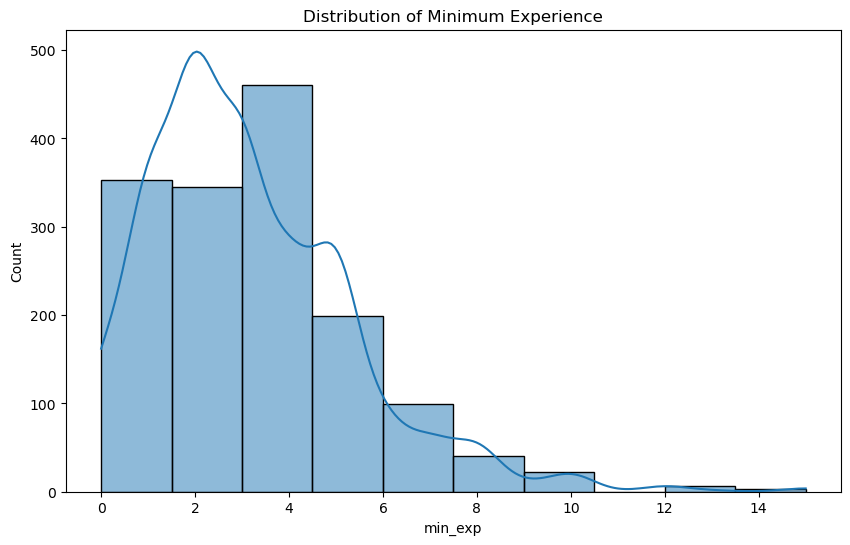

In [55]:
plt.figure(figsize=(10, 6))
sns.histplot(data=data, x='min_exp', bins=10, kde=True)
plt.title('Distribution of Minimum Experience')
plt.show()

### 2. Base Salary Distribution

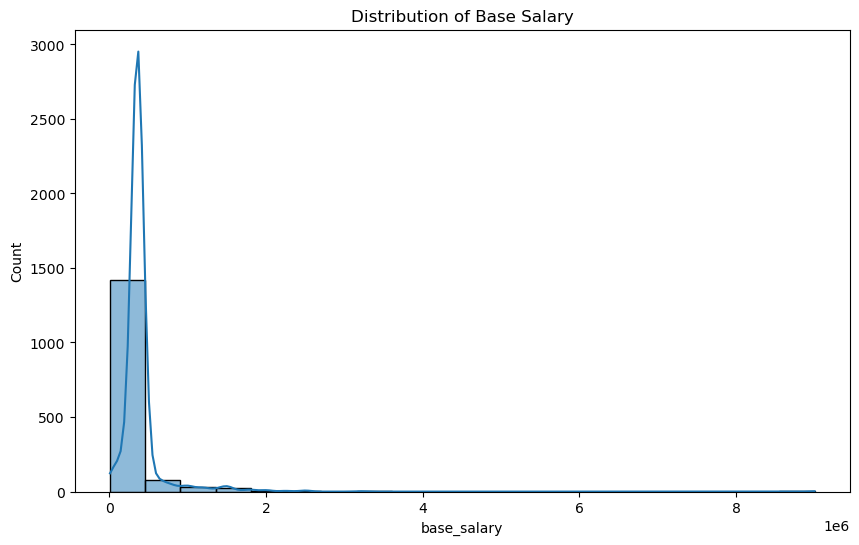

In [58]:
plt.figure(figsize=(10, 6))
sns.histplot(data=data, x='base_salary', bins=20, kde=True)
plt.title('Distribution of Base Salary')
plt.show()

### 3. Max Salary Distribution

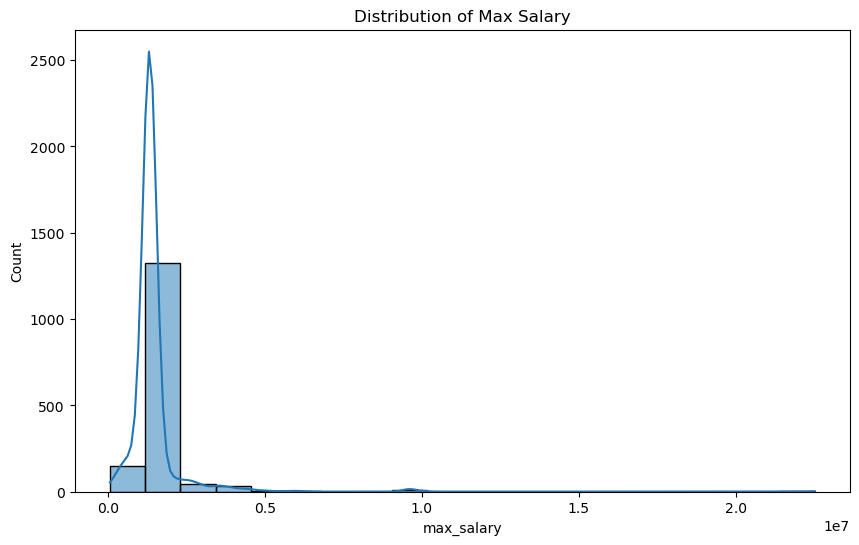

In [61]:
plt.figure(figsize=(10, 6))
sns.histplot(data=data, x='max_salary', bins=20, kde=True)
plt.title('Distribution of Max Salary')
plt.show()

### 4. Average Rating per Job Title

In [64]:
# Calculate average rating per job title
avg_rating = data.groupby('job_title')['rating'].mean().reset_index()

In [66]:
# Sort and select top 10 job titles by average rating
top_job_titles = avg_rating.sort_values(by='rating', ascending=False).head(10)

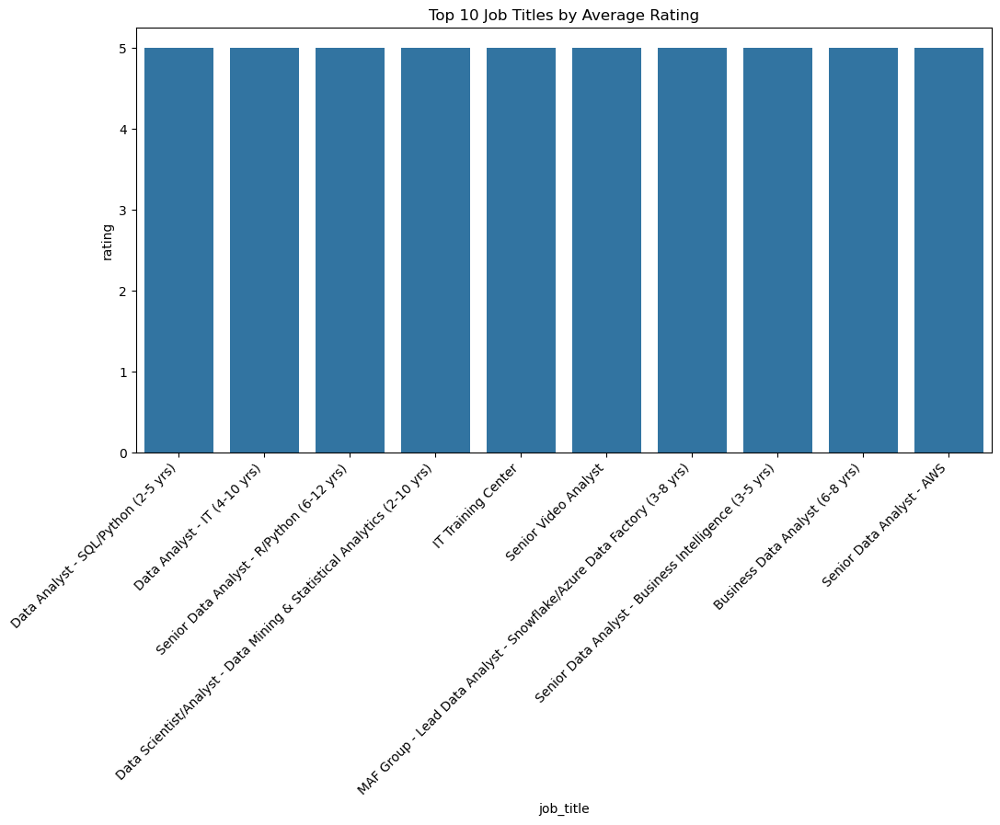

In [68]:
plt.figure(figsize=(12, 6))
sns.barplot(data=top_job_titles, x='job_title', y='rating', estimator='mean')
plt.xticks(rotation=45, ha='right')  # Adjust rotation for better readability
plt.title('Top 10 Job Titles by Average Rating')
plt.show()

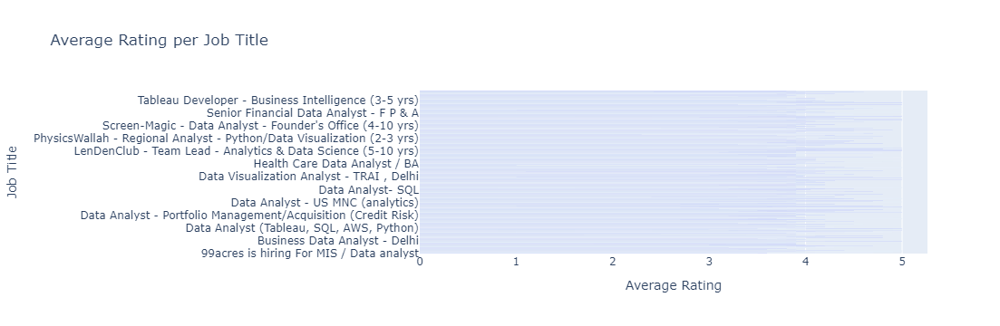

In [70]:
import plotly.express as px

fig = px.bar(avg_rating, x='rating', y='job_title', orientation='h', title='Average Rating per Job Title')
fig.update_layout(yaxis_title='Job Title', xaxis_title='Average Rating')
fig.show()

### 5. Reviews Count per Job Title

In [73]:
# Calculate total reviews count per job title
total_reviews = data.groupby('job_title')['reviews_count'].sum().reset_index()

In [75]:
# Sort and select top 10 job titles by total reviews count
top_10_reviews = total_reviews.sort_values(by='reviews_count', ascending=False).head(10)

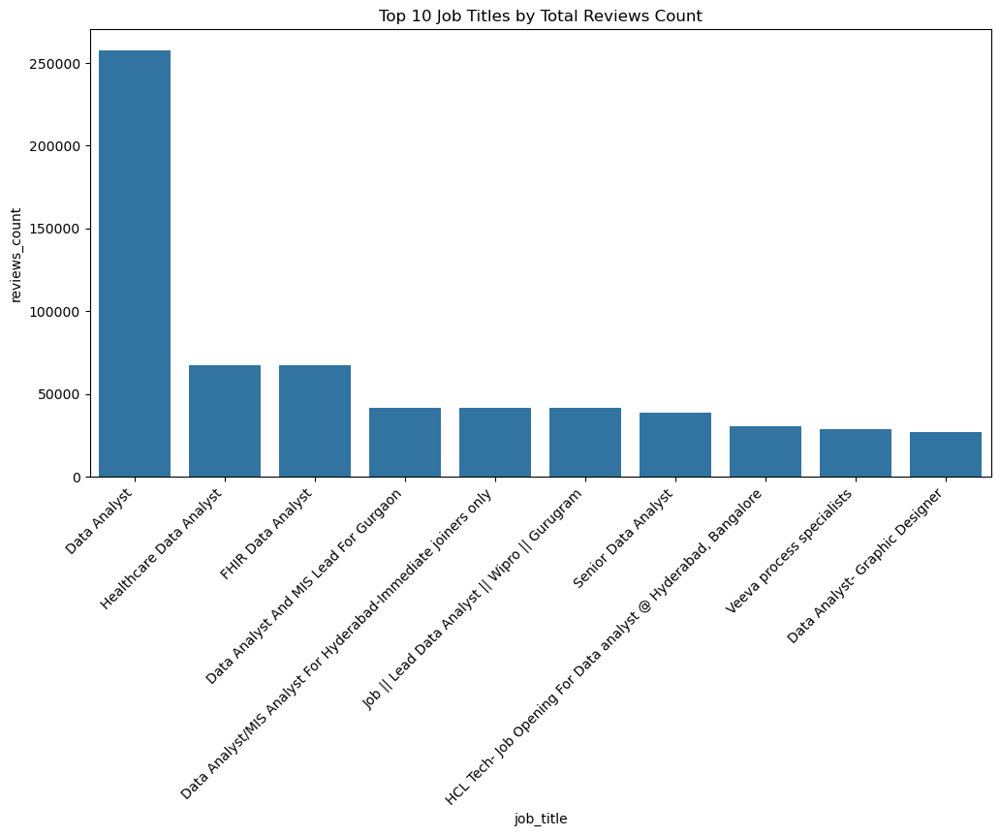

In [77]:
plt.figure(figsize=(12, 6))
sns.barplot(data=top_10_reviews, x='job_title', y='reviews_count', estimator='sum')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.title('Top 10 Job Titles by Total Reviews Count')
plt.show()

### 6. Job Listings by Location

In [80]:
# Count the number of job listings for each location
location_counts = data['location'].value_counts()

In [82]:
# Convert to DataFrame for better readability
location_counts_df = location_counts.reset_index()
location_counts_df.columns = ['Location', 'Number of Job Listings']

In [84]:
# Display the DataFrame
print(location_counts_df)

                                              Location  Number of Job Listings
0                                Bangalore / Bengaluru                     369
1                                               Mumbai                     165
2                             Hyderabad / Secunderabad                     129
3                                   Gurgaon / Gurugram                     115
4                                                 Pune                      90
..                                                 ...                     ...
189                                              Banda                       1
190  Trichy, Chennai, Madurai\n\t\t\t\t\t\t\t\t\t\t...                       1
191                               Delhi/Ncr, New Delhi                       1
192                         Mumbai, Navi Mumbai, Thane                       1
193                                           Hosapete                       1

[194 rows x 2 columns]


In [86]:
top_locations = location_counts_df.head(10)  # Top 10 locations
print("Top 10 Locations with the Most Job Listings:")
print(top_locations)

Top 10 Locations with the Most Job Listings:
                                            Location  Number of Job Listings
0                              Bangalore / Bengaluru                     369
1                                             Mumbai                     165
2                           Hyderabad / Secunderabad                     129
3                                 Gurgaon / Gurugram                     115
4                                               Pune                      90
5                                            Chennai                      81
6                                             Remote                      55
7                                              Noida                      42
8                                          New Delhi                      40
9  Chennai, Pune, New Delhi\n\t\t\t\t\t\t\t\t\t\t...                      31


In [88]:
least_locations = location_counts_df.tail(10)  # Locations with fewest listings
print("Locations with the Fewest Job Listings:")
print(least_locations)

Locations with the Fewest Job Listings:
                                              Location  Number of Job Listings
184  Delhi ncr, Mumbai, Bangalore / Bengaluru\n\t\t...                       1
185                      Cochin/Ernakulam/Kochi, Kochi                       1
186                                            Sonipat                       1
187  Karnataka, Andhra Pradesh, Maharastra\n\t\t\t\...                       1
188  Thiruvananthapuram, Mumbai, Cochin/Ernakulam/K...                       1
189                                              Banda                       1
190  Trichy, Chennai, Madurai\n\t\t\t\t\t\t\t\t\t\t...                       1
191                               Delhi/Ncr, New Delhi                       1
192                         Mumbai, Navi Mumbai, Thane                       1
193                                           Hosapete                       1


In [90]:
location_counts_df['Percentage'] = (location_counts_df['Number of Job Listings'] / location_counts_df['Number of Job Listings'].sum()) * 100
print("Job Listings Distribution by Location:")
print(location_counts_df)

Job Listings Distribution by Location:
                                              Location  \
0                                Bangalore / Bengaluru   
1                                               Mumbai   
2                             Hyderabad / Secunderabad   
3                                   Gurgaon / Gurugram   
4                                                 Pune   
..                                                 ...   
189                                              Banda   
190  Trichy, Chennai, Madurai\n\t\t\t\t\t\t\t\t\t\t...   
191                               Delhi/Ncr, New Delhi   
192                         Mumbai, Navi Mumbai, Thane   
193                                           Hosapete   

     Number of Job Listings  Percentage  
0                       369   23.638693  
1                       165   10.570147  
2                       129    8.263933  
3                       115    7.367072  
4                        90    5.765535  
..          

### 7. Job Listings by PostedIn

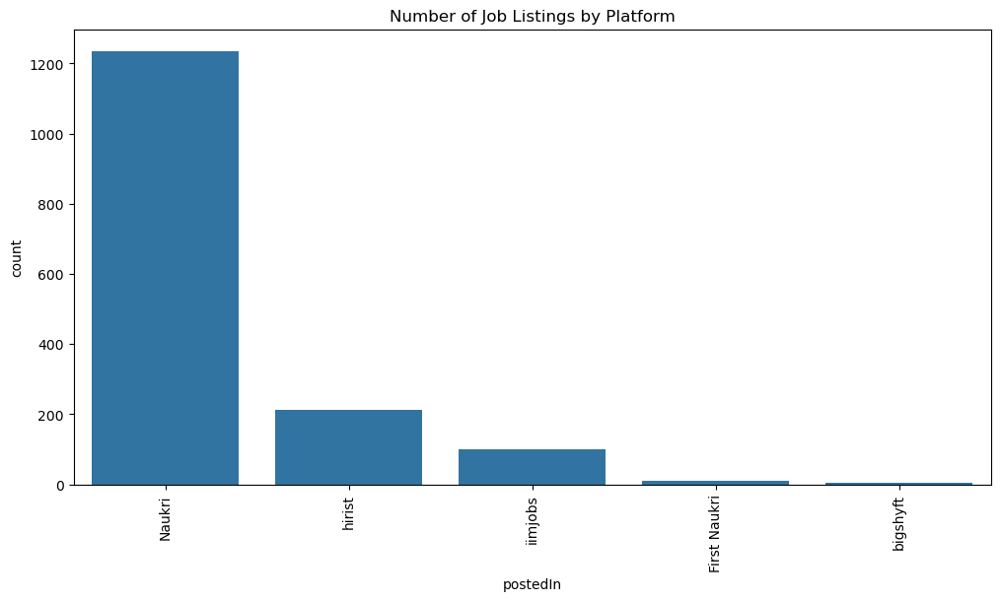

In [93]:
plt.figure(figsize=(12, 6))
sns.countplot(data=data, x='postedIn', order=data['postedIn'].value_counts().index)
plt.xticks(rotation=90)
plt.title('Number of Job Listings by Platform')
plt.show()

### 8. Experience vs Max Salary

In [96]:
# Get top job titles by max salary (you can adjust this number)
top_job_titles = data.groupby('job_title')['max_salary'].max().nlargest(10).index

In [98]:
# Filter data for these top job titles
filtered_data = data[data['job_title'].isin(top_job_titles)]

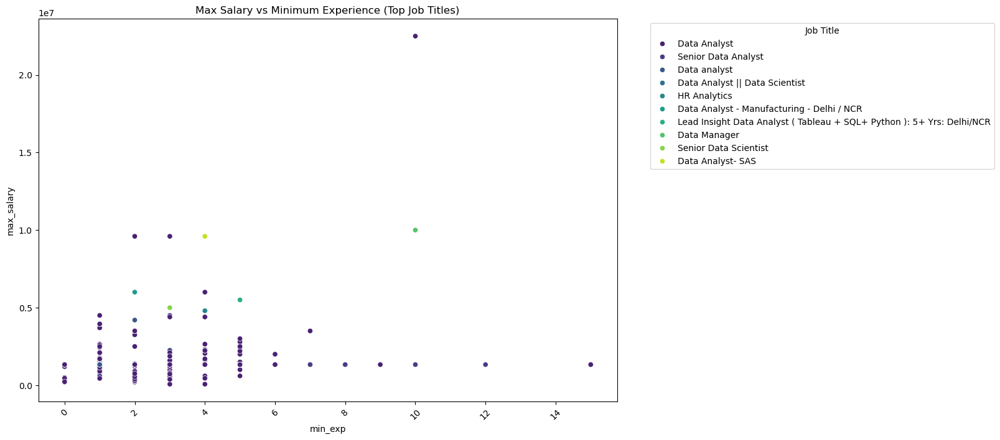

In [100]:
plt.figure(figsize=(12, 8))
sns.scatterplot(data=filtered_data, x='min_exp', y='max_salary', hue='job_title', palette='viridis', legend='full')
plt.title('Max Salary vs Minimum Experience (Top Job Titles)')
plt.xticks(rotation=45)
plt.legend(title='Job Title', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

### 9. Group by Job Title and Aggregate

In [103]:
# Aggregate data by job title
agg_data = data.groupby('job_title').agg({
    'min_exp': 'mean',
    'max_salary': 'mean'
}).reset_index()

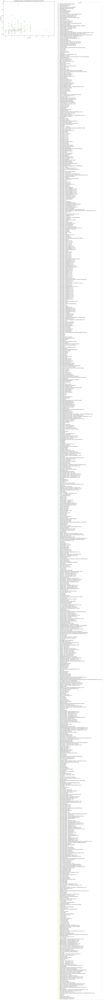

In [105]:
plt.figure(figsize=(12, 8))
sns.scatterplot(data=agg_data, x='min_exp', y='max_salary', hue='job_title', palette='viridis', legend='full')
plt.title('Average Max Salary vs Average Minimum Experience by Job Title')
plt.xticks(rotation=45)
plt.legend(title='Job Title', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

### 10. Use a Facet Grid for Better Clarity

In [108]:
from seaborn import FacetGrid

In [110]:
# Example: create a facet grid with a subset of job titles
top_20_titles = data['job_title'].value_counts().nlargest(20).index
subset_data = data[data['job_title'].isin(top_20_titles)]

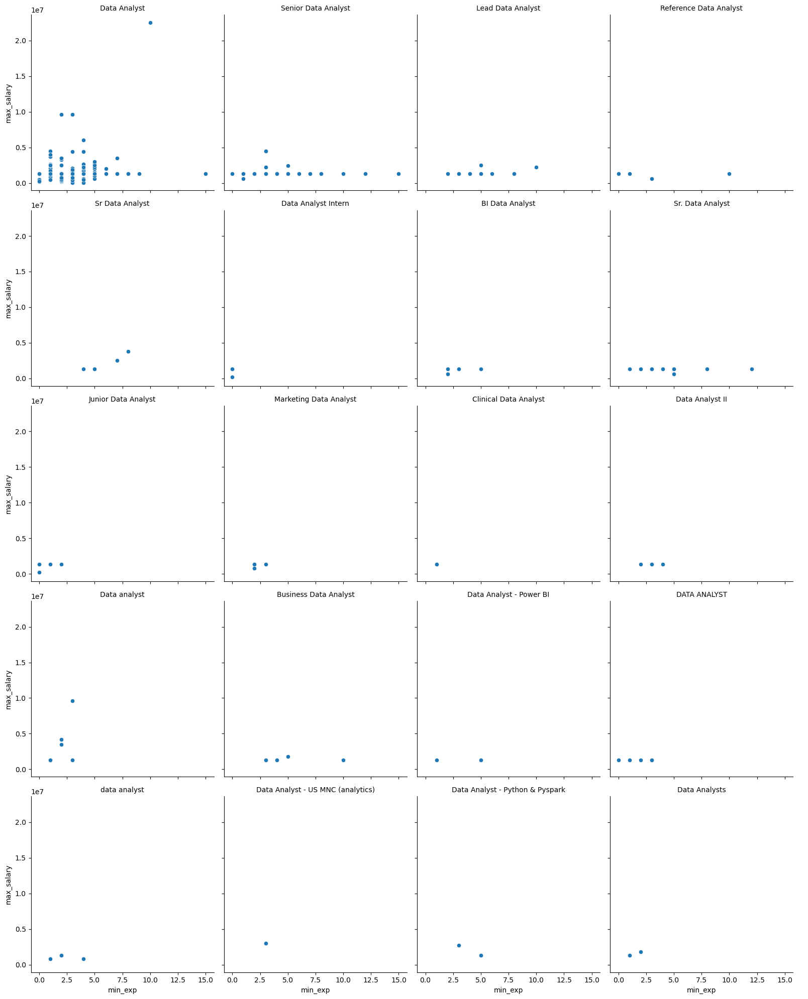

In [112]:
g = FacetGrid(subset_data, col='job_title', col_wrap=4, height=4)
g.map(sns.scatterplot, 'min_exp', 'max_salary')
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.show()

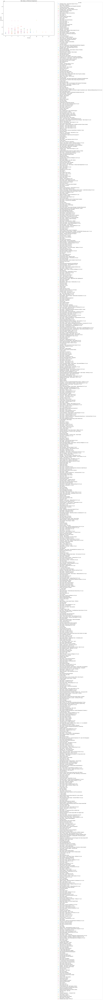

In [114]:
plt.figure(figsize=(12, 8))
sns.scatterplot(data=data, x='min_exp', y='max_salary', hue='job_title', palette='tab20', legend='full', marker='o')
plt.title('Max Salary vs Minimum Experience')
plt.xticks(rotation=45)
plt.legend(title='Job Title', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

### Interactive Plot

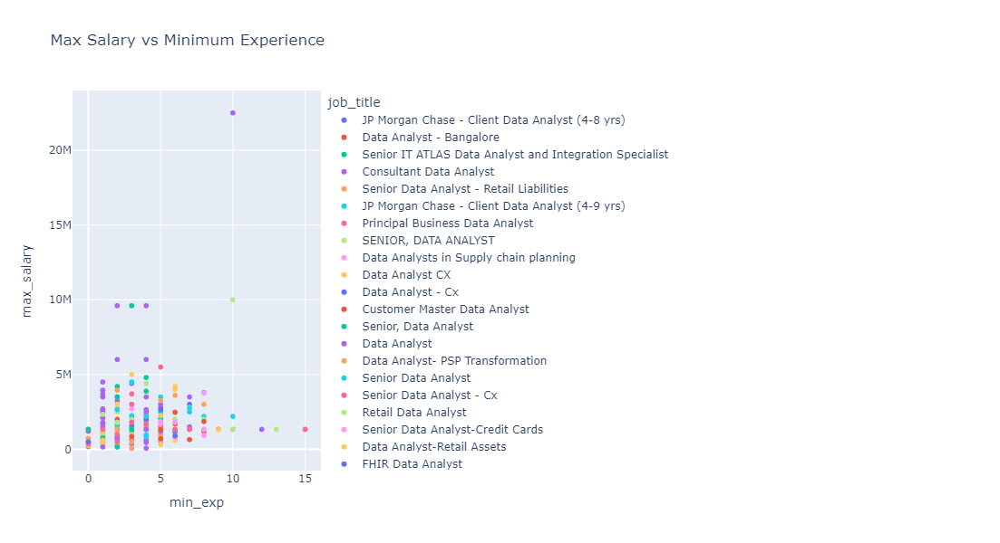

In [117]:
import plotly.express as px

fig = px.scatter(data, x='min_exp', y='max_salary', color='job_title', title='Max Salary vs Minimum Experience')
fig.update_layout(autosize=True, height=600, width=1500)
fig.show()

### 11. Base Salary by Location

In [120]:
# Get top locations by number of job listings
top_locations = data['location'].value_counts().nlargest(10).index

In [122]:
# Filter data for these top locations
filtered_data = data[data['location'].isin(top_locations)]

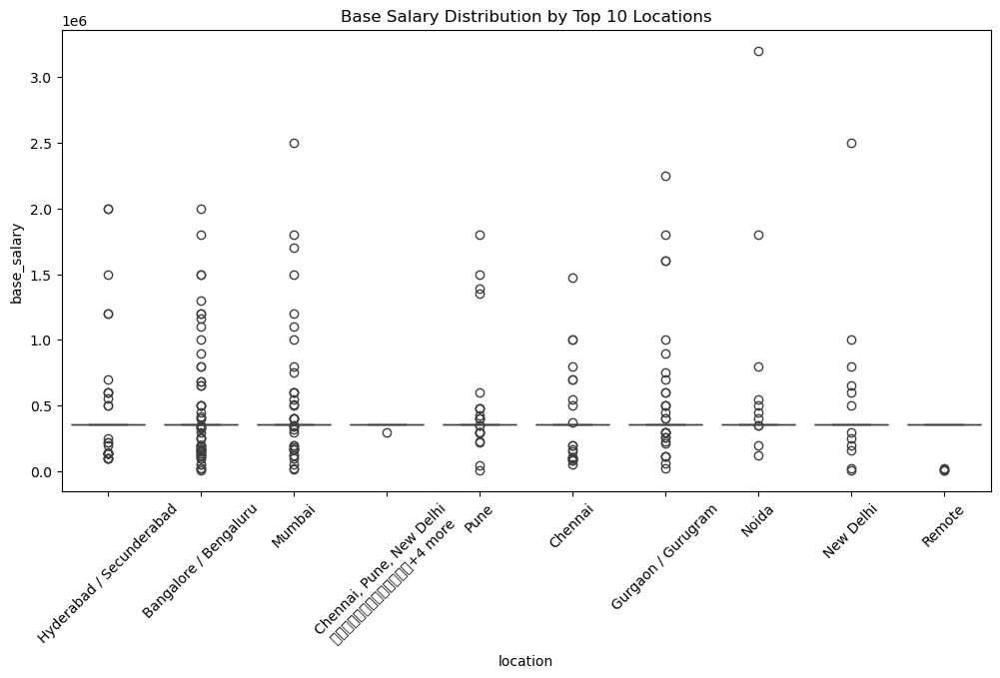

In [124]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=filtered_data, x='location', y='base_salary')
plt.xticks(rotation=45)
plt.title('Base Salary Distribution by Top 10 Locations')
plt.show()

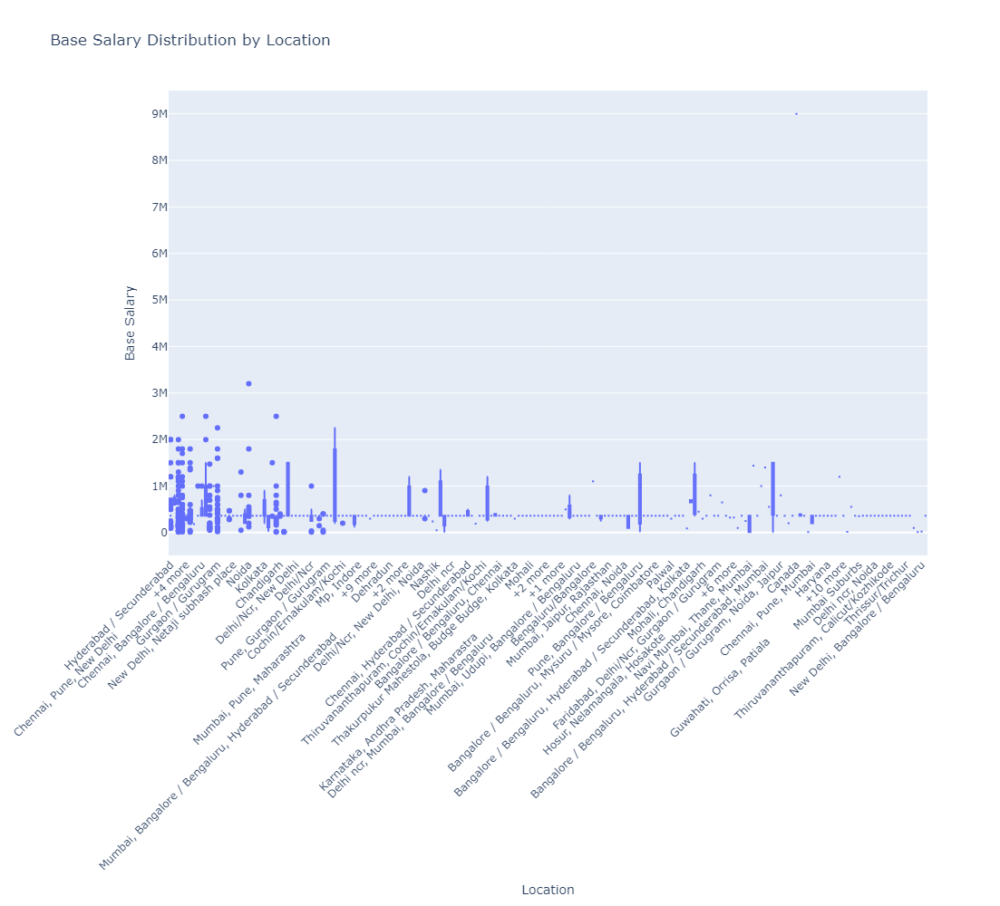

In [126]:
# Create the box plot
fig = px.box(data, x='location', y='base_salary', title='Base Salary Distribution by Location')

# Update layout to increase height
fig.update_layout(
    xaxis_title='Location',
    yaxis_title='Base Salary',
    xaxis_tickangle=-45,
    height=1000
)

# Show the plot
fig.show()

### 12. Correlation Heatmap

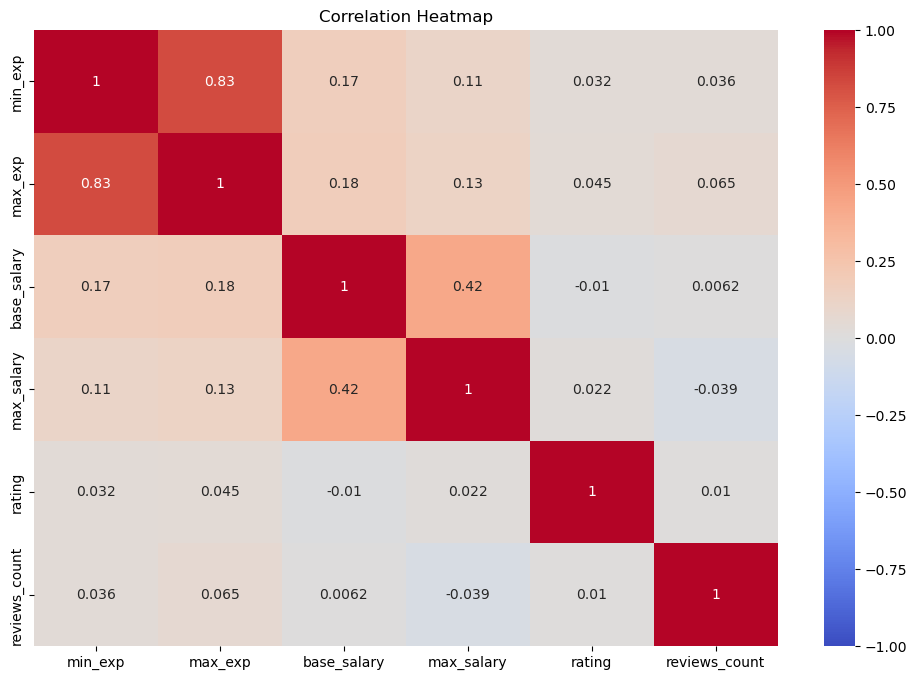

In [129]:
plt.figure(figsize=(12, 8))
corr = data[['min_exp', 'max_exp', 'base_salary', 'max_salary', 'rating', 'reviews_count']].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Heatmap')
plt.show()

### 13. Salary Range by Job Title

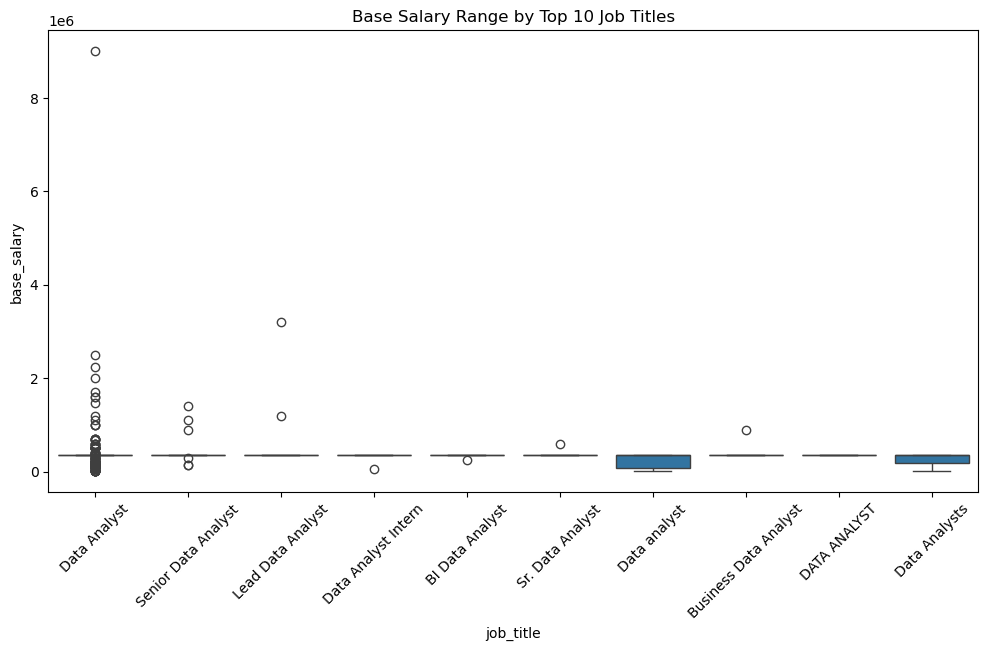

In [132]:
top_job_titles = data['job_title'].value_counts().nlargest(10).index
filtered_data = data[data['job_title'].isin(top_job_titles)]

plt.figure(figsize=(12, 6))
sns.boxplot(data=filtered_data, x='job_title', y='base_salary')
plt.xticks(rotation=45)
plt.title('Base Salary Range by Top 10 Job Titles')
plt.show()

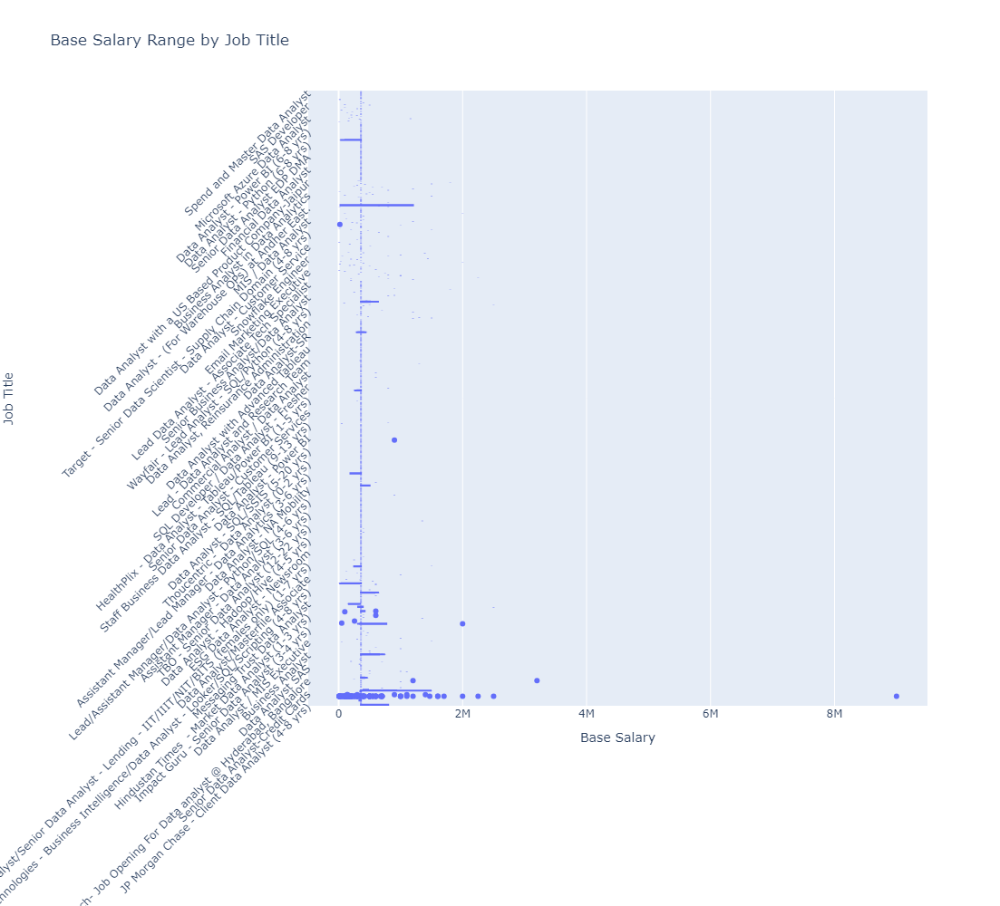

In [134]:
fig = px.box(data, y='job_title', x='base_salary', title='Base Salary Range by Job Title')
fig.update_layout(
    yaxis_title='Job Title',
    xaxis_title='Base Salary',
    yaxis_tickangle=-45,
    height=1000  
)

fig.show()

### 14. Ratings Distribution by Job Title

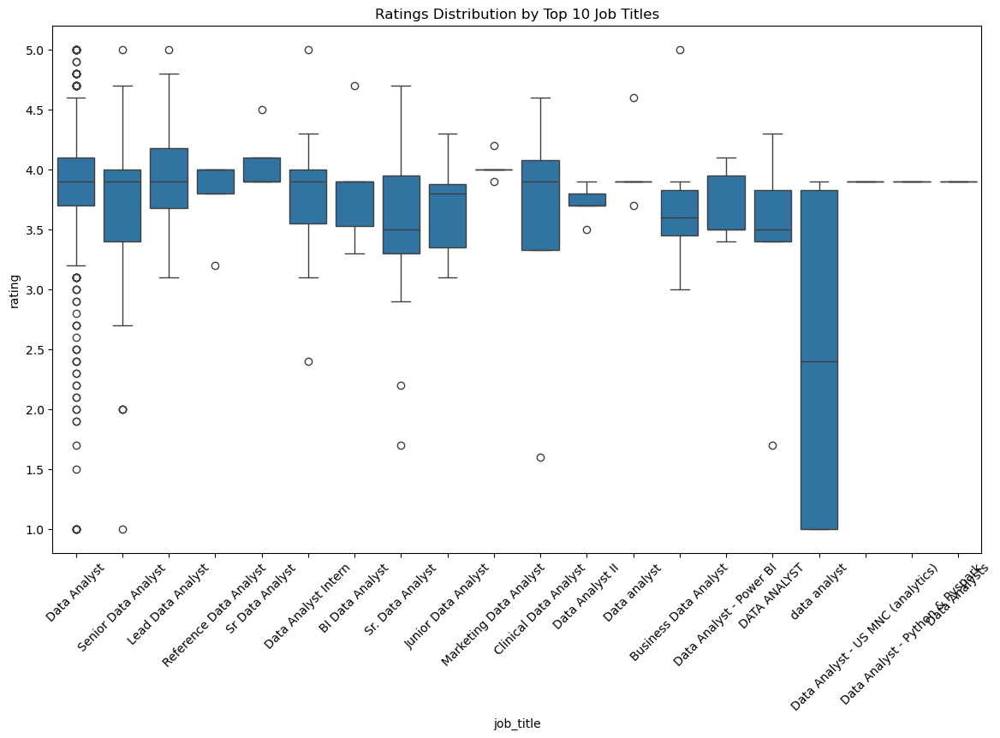

In [137]:
top_job_titles = data['job_title'].value_counts().nlargest(20).index
filtered_data = data[data['job_title'].isin(top_job_titles)]

plt.figure(figsize=(14, 8))
sns.boxplot(data=filtered_data, x='job_title', y='rating')
plt.xticks(rotation=45)
plt.title('Ratings Distribution by Top 10 Job Titles')
plt.show()

### 15. Correlation Between Rating and Reviews Count

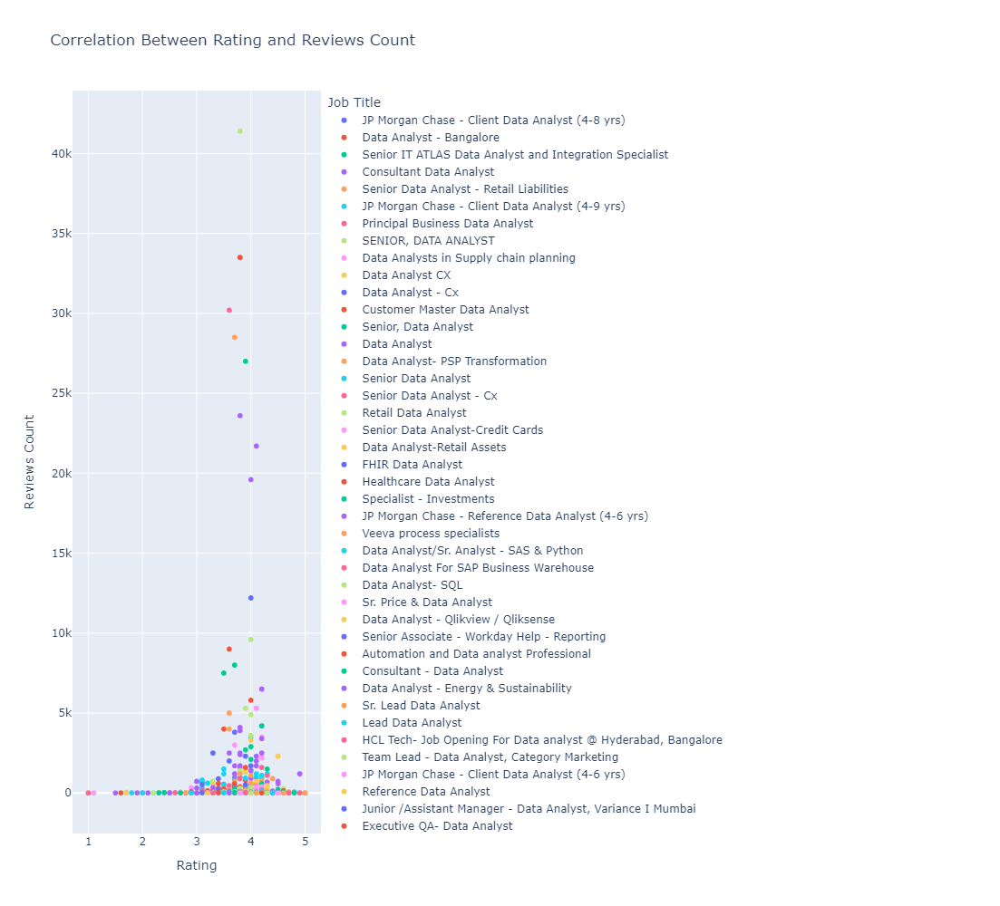

In [140]:
fig = px.scatter(data, x='rating', y='reviews_count', color='job_title', 
                 title='Correlation Between Rating and Reviews Count', 
                 labels={'rating': 'Rating', 'reviews_count': 'Reviews Count'},
                 hover_name='job_title')

fig.update_layout(
    legend_title_text='Job Title',
    height=1000, 
    xaxis_title='Rating',
    yaxis_title='Reviews Count'
)

fig.show()

### 16. Base Salary and Max Salary vs Job Listed Days Ago

In [143]:
# Create scatter plot for base salary
fig = px.scatter(data, x='jobListed(days_ago)', y='base_salary', color='job_title',
                 title='Base Salary and Max Salary vs Job Listed Days Ago',
                 labels={'jobListed(days_ago)': 'Job Listed Days Ago', 'base_salary': 'Base Salary'},
                 color_continuous_scale=px.colors.sequential.Viridis)


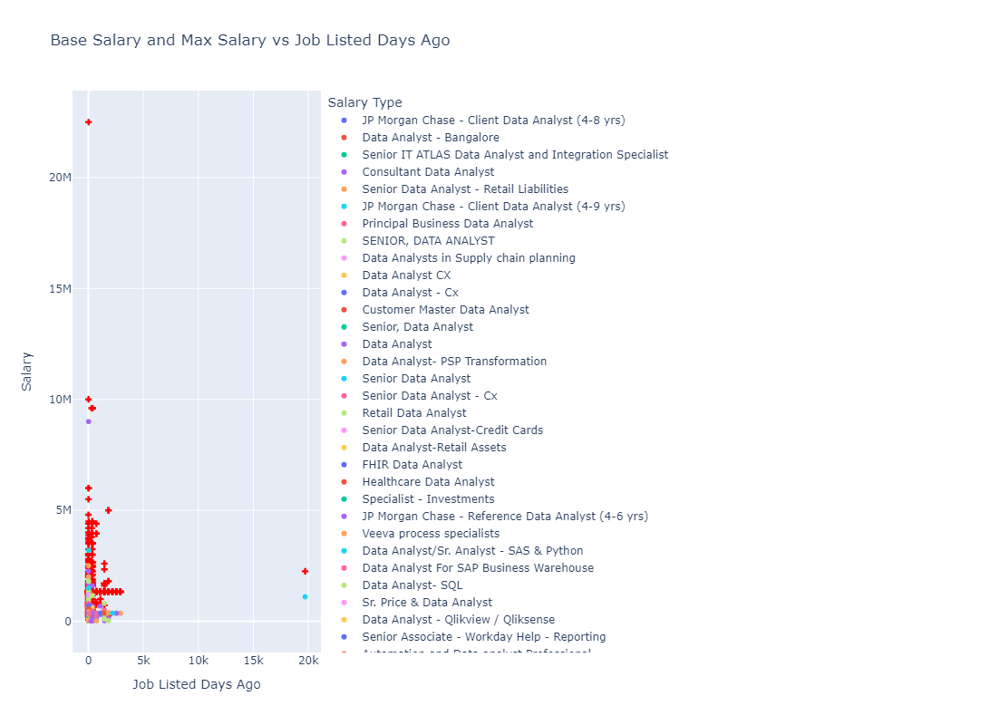

In [145]:
# Add scatter plot for max salary
fig.add_scatter(x=data['jobListed(days_ago)'], y=data['max_salary'], mode='markers',
                marker=dict(color='red', symbol='cross'), name='Max Salary')

fig.update_layout(
    xaxis_title='Job Listed Days Ago',
    yaxis_title='Salary',
    legend_title='Salary Type',
    width=1200,  
    height=800   
)

fig.show()

### 17. Interactive Scatter Plot

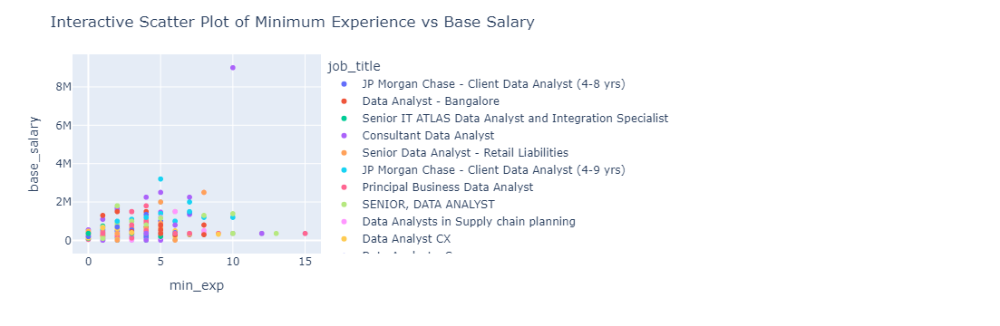

In [148]:
fig = px.scatter(data, x='min_exp', y='base_salary', color='job_title', hover_data=['company'])
fig.update_layout(title='Interactive Scatter Plot of Minimum Experience vs Base Salary')
fig.show()

### 18. Interactive Heatmap

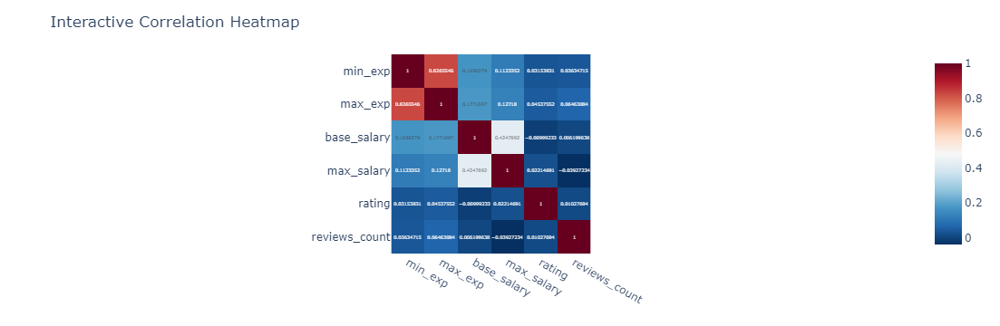

In [151]:
fig = px.imshow(corr, text_auto=True, color_continuous_scale='RdBu_r')
fig.update_layout(title='Interactive Correlation Heatmap')
fig.show()

### 19. Location vs Experience Level

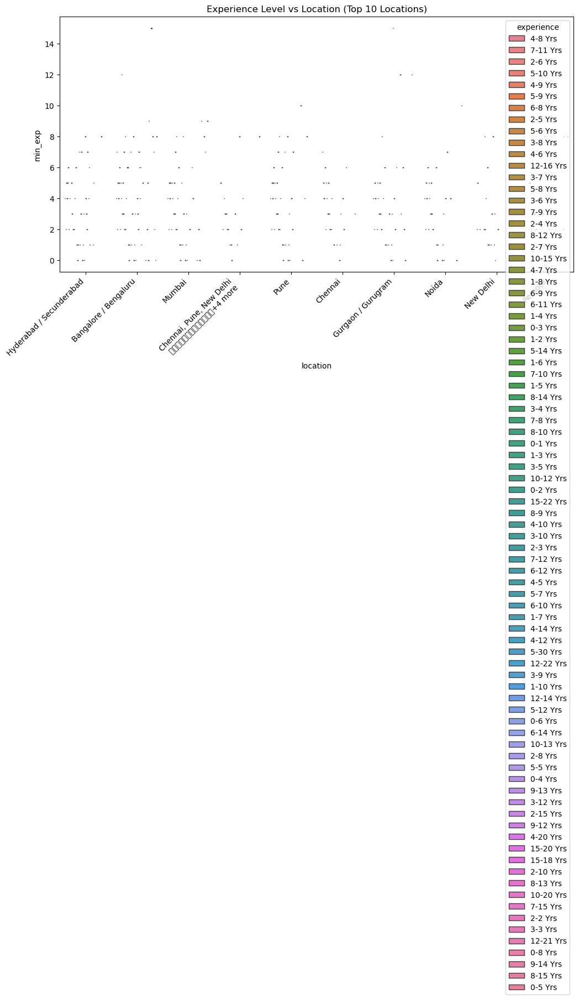

In [154]:
top_locations = data['location'].value_counts().head(10).index
filtered_data = data[data['location'].isin(top_locations)]

plt.figure(figsize=(12, 6))
sns.boxplot(data=filtered_data, x='location', y='min_exp', hue='experience')
plt.xticks(rotation=45, ha='right')
plt.title('Experience Level vs Location (Top 10 Locations)')
plt.show()

### 20. Base Salary and Max Salary vs Job Listed Days Ago

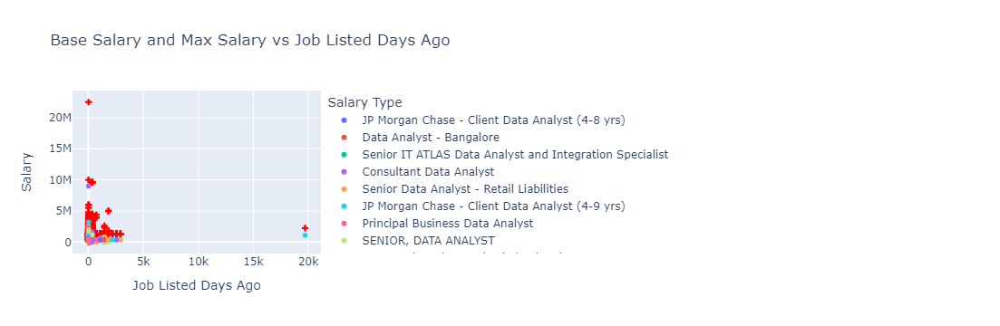

In [157]:
fig = px.scatter(data, x='jobListed(days_ago)', y='base_salary', color='job_title',
                 title='Base Salary and Max Salary vs Job Listed Days Ago',
                 labels={'jobListed(days_ago)': 'Job Listed Days Ago', 'base_salary': 'Base Salary'},
                 color_continuous_scale=px.colors.sequential.Viridis)
fig.add_scatter(x=data['jobListed(days_ago)'], y=data['max_salary'], mode='markers',
                marker=dict(color='red', symbol='cross'), name='Max Salary')

fig.update_layout(
    xaxis_title='Job Listed Days Ago',
    yaxis_title='Salary',
    legend_title='Salary Type'
)

fig.show()


### 21. Interactive Heatmap 

In [160]:
# Create a pivot table for the heatmap
heatmap_data = data.pivot_table(index='location', columns='experience', values='job_title', aggfunc='count', fill_value=0)

# Create the interactive heatmap
fig = px.imshow(
    heatmap_data,
    color_continuous_scale='Viridis',
    title='Interactive Heatmap of Job Listings by Location and Experience Level',
    labels={'x': 'Experience Level', 'y': 'Location', 'color': 'Number of Job Listings'}
)

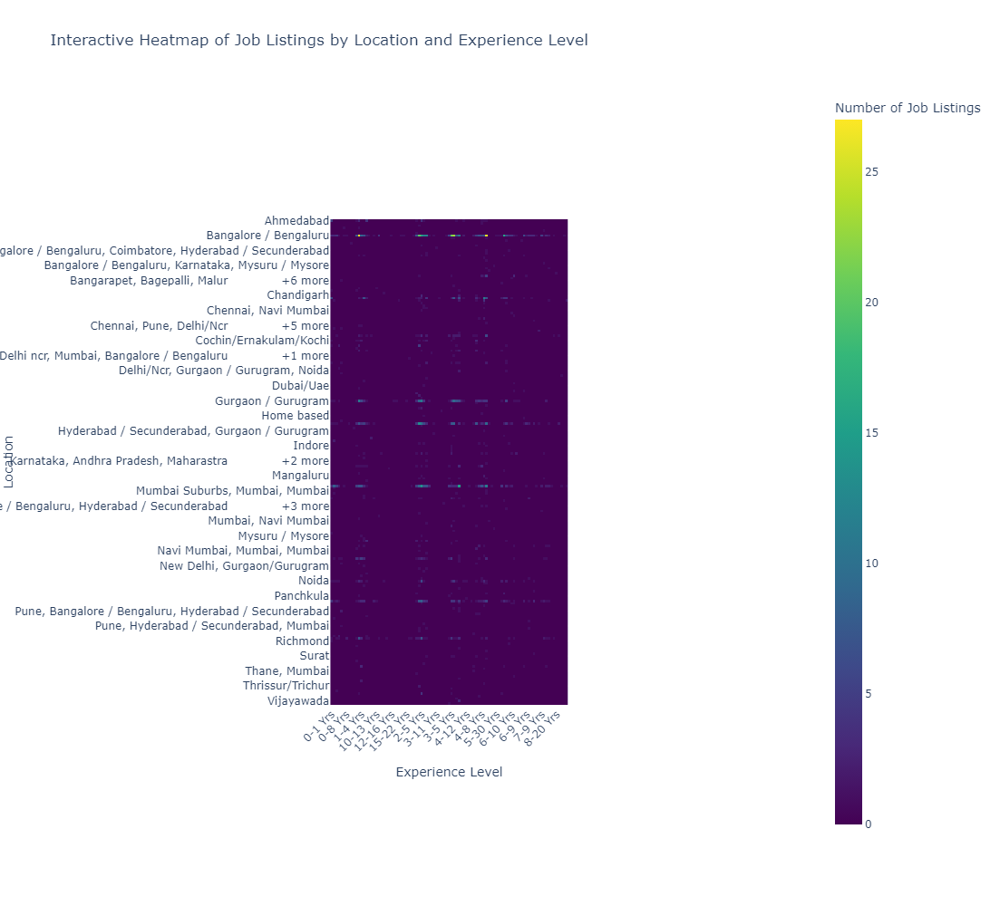

In [162]:
fig.update_layout(
    xaxis_title='Experience Level',
    yaxis_title='Location',
    xaxis=dict(tickangle=-45, tickmode='array'), 
    yaxis=dict(tickmode='array'),  
    height=1000,  
    width=1500  
)

fig.show()

## Conclusion 

This project provided a detailed analysis of job market data, focusing on experience requirements, salary distributions, job ratings, and location-based trends. Key findings include:

- **Experience and Salary Trends**: Salaries generally increase with experience, with notable variations across job titles and locations.
- **Job Ratings and Reviews**: Higher ratings are associated with more reviews, indicating greater feedback engagement.
- **Geographic Insights**: Job availability and compensation vary significantly by location, reflecting regional job market dynamics.